In [ ]:
import pandas as pd
import numpy as np
import tensorflow as tf
import math
import pydicom
from PIL import Image
import os
from keras.preprocessing.image import ImageDataGenerator
import seaborn as sns
import matplotlib.pyplot as plt
from keras.utils import to_categorical
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization
from keras import regularizers
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, LearningRateScheduler
from sklearn.model_selection import StratifiedKFold, train_test_split
from sklearn.metrics import classification_report, confusion_matrix
from tensorflow.keras.utils import to_categorical
from sklearn.preprocessing import LabelEncoder
import cv2
import plotly.express as px
import warnings
import time
from keras.regularizers import l2
from keras.applications import VGG16

warnings.filterwarnings("ignore", category=UserWarning)

num_epochs=30

In [ ]:
current_directory = os.getcwd()

# Functions

In [ ]:
import vtk

def scan_3d(folder_path, threshold_value=1000, output_file='output_image.png'):
    valid_thresholds= [-800, 1000]
    #saved dcm images in the conv folder to load in
    reader= vtk.vtkDICOMImageReader()
    reader.SetDirectoryName(folder_path)
    reader.Update()
    #seeing the highest HU and the lowest HU
    scalar_range = reader.GetOutput().GetScalarRange()
    print("Scalar Range:", scalar_range)
    #getting the bone density or skin. threshold his based on the hu
    threshold = vtk.vtkImageThreshold()
    threshold.SetInputConnection(reader.GetOutputPort())
    threshold.ThresholdByUpper(threshold_value)
    threshold.ReplaceInOn()
    threshold.SetInValue(1)
    threshold.ReplaceOutOn()
    threshold.SetOutValue(0)
    # builds the face
    contour= vtk.vtkContourFilter()
    contour.SetInputConnection(threshold.GetOutputPort())
    contour.SetValue(0, 1)
    mapper = vtk.vtkPolyDataMapper()
    mapper.SetInputConnection(contour.GetOutputPort())
    actor = vtk.vtkActor()
    actor.SetMapper(mapper)
    # rotating the image to capture the face for the export
    transform = vtk.vtkTransform()
    transform.RotateWXYZ(110, 1, 0, 0)
    actor.SetUserTransform(transform)
    # changing the colour from blue to grey
    color_map = vtk.vtkColorTransferFunction()
    color_map.AddRGBPoint(scalar_range[0], 0.517, 0.533, 0.517)
    color_map.AddRGBPoint(scalar_range[1], 0.517, 0.533, 0.517)
    mapper.SetLookupTable(color_map)
    #renderer, window, etc.
    renderer = vtk.vtkRenderer()
    renderWindow = vtk.vtkRenderWindow()
    renderWindow.AddRenderer(renderer)
    renderWindowInteractor = vtk.vtkRenderWindowInteractor()
    renderWindowInteractor.SetRenderWindow(renderWindow)
    renderer.AddActor(actor)
    renderer.SetBackground(0, 0, 0)
    renderWindow.Render()
    #saving image
    window_to_image_filter = vtk.vtkWindowToImageFilter()
    window_to_image_filter.SetInput(renderWindow)
    window_to_image_filter.Update()
    writer = vtk.vtkPNGWriter()
    writer.SetFileName(output_file)
    writer.SetInputConnection(window_to_image_filter.GetOutputPort())
    writer.Write()
    #can only open in a separate window
    renderWindow.Render()
    renderWindowInteractor.Start()

Guides used for vtk logic
https://vtk.org/doc/nightly/html/classvtkDICOMImageReader.html
https://www.kaggle.com/code/wrrosa/advanced-dicom-ct-3d-visualizations-with-vtk
https://www.youtube.com/watch?v=QDJgbSQnhjc&list=TLPQMTYwMjIwMjQv7Qqq0uhQpw&index=2

https://www.youtube.com/watch?v=KnUWusfKo7w

In [ ]:
def image_class(images, labels, class_name):
    #get class index
    class_index = np.where(class_names == class_name)[0][0]

    #getting correct class
    class_images = images[labels == class_index]

    if len(class_images) == 0:
        print(f"No images found for the '{class_name}' class.")
    else:
        #showing the max images
        class_images = class_images[:90]
        num_rows = math.ceil(len(class_images) / 10)

        fig, axes = plt.subplots(num_rows, 10, figsize=(30, 30))

        for i, ax in enumerate(axes.flat):
            if i < len(class_images):
                ax.imshow(class_images[i])
                ax.axis('off')
                ax.set_title(class_name)
            else:
                ax.axis('off')

        plt.tight_layout()
        print("A maximum of 90 images will be shown")
        plt.show()


In [ ]:
def cnn(drop_out=0.1, optimiser='adadelta'):
    model = Sequential()
    model.add(Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)))
    model.add(MaxPooling2D((2, 2)))
    model.add(Conv2D(64, (3, 3), activation='relu'))
    model.add(MaxPooling2D((2, 2)))
    model.add(Flatten())
    model.add(Dropout(drop_out))
    model.add(Dense(128, activation='relu'))
    model.add(Dense(num_classes, activation='softmax'))

    model.compile(optimizer=optimiser, loss='categorical_crossentropy', metrics=['accuracy'])
    return model

In [ ]:

def plot_accuracy(hist, num_epochs):
    epochs = list(range(num_epochs))
    plt.plot(epochs, hist['val_accuracy'], label="val_accuracy")
    plt.plot(epochs, hist['accuracy'], label="accuracy")
    plt.xlabel("Epochs")
    plt.ylabel("Accuracy")
    plt.title("Training and Validation Accuracy")
    plt.legend()
    plt.show()

In [ ]:
def plot_validation(hist, num_epochs):
    epochs = list(range(num_epochs))
    plt.plot(epochs, hist['val_loss'], label="val_loss")
    plt.plot(epochs, hist['loss'], label="loss")
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.title("Training and Validation Loss")
    plt.legend()
    plt.show()


In [ ]:
def confusion_m(y_true,y_pred):
    conf_matrix = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(6, 4))
    sns.heatmap(conf_matrix, annot=True, cmap="viridis",
            xticklabels=class_names, yticklabels=class_names)
    plt.xlabel("Predicted labels")
    plt.ylabel("True labels")
    plt.title("Confusion Matrix")
    plt.show()

In [ ]:
def class_report(model,X_test,y_test):
    #classification report, convert data to categorical
    y_pred = model.predict(X_test)

    y_pred_labels = np.argmax(y_pred, axis=1)
    y_true_labels = np.argmax(y_test, axis=1)

    report = classification_report(y_true_labels, y_pred_labels)

    return report,y_pred_labels,y_true_labels

# Exploratory data analysis

In [ ]:
# getting image information
df= pd.read_csv('ct_brain.csv',dtype={'type':'category'})

In [ ]:
print(f"There are {df.shape[0]} images")
df.head()

There are 256 images


,dcm,jpg,type
0,/aneurysm/0.dcm,/aneurysm/0.jpg,aneurysm
1,/aneurysm/1.dcm,/aneurysm/1.jpg,aneurysm
2,/aneurysm/2.dcm,/aneurysm/2.jpg,aneurysm
3,/aneurysm/3.dcm,/aneurysm/3.jpg,aneurysm
4,/aneurysm/4.dcm,/aneurysm/4.jpg,aneurysm


In [ ]:
# image counts

brain_class= df['type'].value_counts().reset_index()

brain_class.columns= ['type', 'count']
fig= px.bar(brain_class, x='type', y= "count",color="type")
print("There are:")
for index, row in brain_class.iterrows():
    print(f"{row['count']} images for {row['type']}s.")
fig.show()



There are:
90 images for cancers.
83 images for aneurysms.
83 images for tumors.


# Importing DICOM files

DICOMs are interesting files as they contain information about the patients, this will help us to see information, such as how many patients are there, age, sex etc.

In [ ]:
# viewing dicom file to establish what is in the meta data
dicom_path =  'files\\aneurysm\9.dcm'

dicom_meta = pydicom.dcmread(dicom_path)

dicom_meta



Dataset.file_meta -------------------------------
(0002, 0000) File Meta Information Group Length  UL: 166
(0002, 0001) File Meta Information Version       OB: b'\x00\x01'
(0002, 0002) Media Storage SOP Class UID         UI: CT Image Storage
(0002, 0003) Media Storage SOP Instance UID      UI: 1253950850086005615754110327549
(0002, 0010) Transfer Syntax UID                 UI: Explicit VR Little Endian
(0002, 0012) Implementation Class UID            UI: 1.2.826.0.1.3680043.8.2198
(0002, 0013) Implementation Version Name         SH: ''
(0002, 0016) Source Application Entity Title     AE: ''
-------------------------------------------------
(0008, 0008) Image Type                          CS: ['ORIGINAL', 'PRIMARY', 'AXIAL']
(0008, 0016) SOP Class UID                       UI: CT Image Storage
(0008, 0018) SOP Instance UID                    UI: 1253950850086005615754110327549
(0008, 0020) Study Date                          DA: '20190628'
(0008, 0050) Accession Number                  

From viewing the data we can take out some useful information PatientID, StudyID, InstanceNumber etc (https://towardsdatascience.com/understanding-dicom-bce665e62b72)

In [ ]:
# capturing metat data
dicom_data_list = []

# importing all dcm files to python
for index, row in df.iterrows():
    dicom_path ='files'+row["dcm"]

    # reading the metadata
    dicom_data = pydicom.dcmread(dicom_path)

    # taking some information from the metadata file
    dicom_info = {
        'PatientOrientation': str(dicom_data.PatientOrientation),
        'StudyDescription': str(dicom_data.StudyDescription),
        'StudyID':str(dicom_data.StudyID),
        'StudyInstanceUID':str(dicom_data.StudyInstanceUID),
        'SeriesInstanceUID':str(dicom_data.SeriesInstanceUID),
        'InstanceNumber':str(dicom_data.InstanceNumber),
        'ImageType': str(dicom_data.ImageType),
        'Modality': str(dicom_data.Modality),
        'StudyDate': str(dicom_data.StudyDate),
        'PatientID': str(dicom_data.PatientID),
        'PatientSex': str(dicom_data.PatientSex),
        'ProtocolName': str(dicom_data.ProtocolName),
        'PatientAge': str(dicom_data.PatientAge),
        'ImageOrientation': str(dicom_data.ImageOrientationPatient),
        'ImagePositionPatient': str(dicom_data.ImagePositionPatient),
        'BodyPartExamined': str(dicom_data.BodyPartExamined),
        'PatientPosition':str(dicom_data.PatientPosition),
        'SliceThickness': str(dicom_data.SliceThickness),
        'Manufacturer': str(dicom_data.Manufacturer),
        'ManufacturerModelName': str(dicom_data.ManufacturerModelName)

    }

    #appending to list
    dicom_data_list.append(dicom_info)



# transorming list into dataframe
dicom_df = pd.DataFrame(dicom_data_list)

dicom_df.head()


,PatientOrientation,StudyDescription,StudyID,StudyInstanceUID,SeriesInstanceUID,InstanceNumber,ImageType,Modality,StudyDate,PatientID,PatientSex,ProtocolName,PatientAge,ImageOrientation,ImagePositionPatient,BodyPartExamined,PatientPosition,SliceThickness,Manufacturer,ManufacturerModelName
0,"['L', 'P']",HEAD,65647964486341333040345223795591,31187487675118671925041610759088,38041590723031324187586477972361,1,"['ORIGINAL', 'PRIMARY', 'AXIAL']",CT,20190628,88252517737529177653766698275190,F,Brain HCT,071Y,"[1, 0, 0, 0, 1, 0]","[-117.871, -138.496, -520.5]",HEAD,HFS,2,TOSHIBA,Aquilion
1,"['L', 'P']",HEAD,65647964486341333040345223795591,31187487675118671925041610759088,38041590723031324187586477972361,2,"['ORIGINAL', 'PRIMARY', 'AXIAL']",CT,20190628,88252517737529177653766698275190,F,Brain HCT,071Y,"[1, 0, 0, 0, 1, 0]","[-117.871, -138.496, -518.5]",HEAD,HFS,2,TOSHIBA,Aquilion
2,"['L', 'P']",HEAD,65647964486341333040345223795591,31187487675118671925041610759088,38041590723031324187586477972361,3,"['ORIGINAL', 'PRIMARY', 'AXIAL']",CT,20190628,88252517737529177653766698275190,F,Brain HCT,071Y,"[1, 0, 0, 0, 1, 0]","[-117.871, -138.496, -516.5]",HEAD,HFS,2,TOSHIBA,Aquilion
3,"['L', 'P']",HEAD,65647964486341333040345223795591,31187487675118671925041610759088,38041590723031324187586477972361,4,"['ORIGINAL', 'PRIMARY', 'AXIAL']",CT,20190628,88252517737529177653766698275190,F,Brain HCT,071Y,"[1, 0, 0, 0, 1, 0]","[-117.871, -138.496, -514.5]",HEAD,HFS,2,TOSHIBA,Aquilion
4,"['L', 'P']",HEAD,65647964486341333040345223795591,31187487675118671925041610759088,38041590723031324187586477972361,5,"['ORIGINAL', 'PRIMARY', 'AXIAL']",CT,20190628,88252517737529177653766698275190,F,Brain HCT,071Y,"[1, 0, 0, 0, 1, 0]","[-117.871, -138.496, -512.5]",HEAD,HFS,2,TOSHIBA,Aquilion


In [ ]:
#view all columns
pd.set_option('display.max_columns', None)

print(dicom_df["ProtocolName"].unique())
print(dicom_df["PatientAge"].unique())

#summarise the dataframe
dicom_df.describe()

['Brain HCT' 'Brain Child 6-12 yrs (HCT)']
['071Y' '008Y' '027Y']


,PatientOrientation,StudyDescription,StudyID,StudyInstanceUID,SeriesInstanceUID,InstanceNumber,ImageType,Modality,StudyDate,PatientID,PatientSex,ProtocolName,PatientAge,ImageOrientation,ImagePositionPatient,BodyPartExamined,PatientPosition,SliceThickness,Manufacturer,ManufacturerModelName
count,256,256,256,256,256,256,256,256,256,256,256,256,256,256,256,256,256,256,256,256
unique,1,1,3,3,3,90,1,1,3,3,2,2,3,1,256,1,1,1,1,1
top,"['L', 'P']",HEAD,67001246755920659650543272572319,27226562536539860827243991552367,37049508755620684031715988549388,1,"['ORIGINAL', 'PRIMARY', 'AXIAL']",CT,20170106,64564456228714525163852073726767,F,Brain HCT,027Y,"[1, 0, 0, 0, 1, 0]","[-117.871, -138.496, -520.5]",HEAD,HFS,2,TOSHIBA,Aquilion
freq,256,256,90,90,90,3,256,256,90,90,173,173,90,256,1,256,256,256,256,256


From the data summary, it appears as thought there are only 3 patients. Let's double check

In [ ]:
summary = dicom_df.groupby("PatientID").agg({'StudyDate':'nunique','ImagePositionPatient':'nunique',
                                            'ProtocolName':'unique','PatientAge':'unique',
                                            'PatientSex':'unique'}).reset_index()
summary

,PatientID,StudyDate,ImagePositionPatient,ProtocolName,PatientAge,PatientSex
0,64564456228714525163852073726767,1,90,[Brain HCT],[027Y],[F]
1,65861267898761825936981934122362,1,83,[Brain Child 6-12 yrs (HCT)],[008Y],[M]
2,88252517737529177653766698275190,1,83,[Brain HCT],[071Y],[F]


checking the 3d scans

In [ ]:
scan_3d('conv/tumor', threshold_value=1000, output_file='skeleton.png')

Scalar Range: (-2048.0, 4702.0)


In [ ]:
scan_3d('conv/tumor', threshold_value=-800, output_file='skin.png')

Scalar Range: (-2048.0, 4702.0)


We can see that there is a male child aged 8, 27 year old and a 71 year old female. Differences in age may have an impact on the brain e.g. size of the brain, childhood brain is developing and later in life the brain shrinks.

Suspicions seem to be correct, only 3 patients. DICOMS are made up of slices, we are working with a 3D scan and so there can be many slices. It is fair to conclude that these DICOMs are based on 3 patiends scan of their brains.

# Data preparation

In [ ]:
# importing images
images= []
for index, row in df.iterrows():
    image_path= 'files' + row["jpg"]

    # Open the image using PIL instead of cv2
    image= Image.open(image_path)

    # resizing images 224x224 is commonly used for vgg16
    image= image.resize((224, 224))

    image= np.array(image)

    # Normalising the pixe,s
    image= image.astype('float32')/255.0
    images.append(image)

images =np.array(images)

In [ ]:
# checking to see if normalised and if all files have been imported
print("max value:",images[0].max())
print("min value:",images[0].min())
print("count, size and RGB:",images.shape)

max value: 1.0
min value: 0.0
count, size and RGB: (256, 224, 224, 3)


In [ ]:
# Encoding the data, this will help to change the names from 0,1,2 to their actual classification names
label_encoder = LabelEncoder()

labels= label_encoder.fit_transform(df['type'])

num_classes= len(label_encoder.classes_)

class_names= label_encoder.classes_



In [ ]:
np.random.seed(123)
#shuffle images
indices = np.arange(len(images))
np.random.shuffle(indices)
shuffled_images = images[indices]
shuffled_labels = labels[indices]


In [ ]:
shuffled_labels

array([0, 0, 2, 1, 1, 1, 1, 1, 0, 0, 1, 2, 2, 0, 1, 0, 1, 1, 2, 0, 1, 2,
       1, 0, 2, 1, 2, 1, 2, 1, 0, 0, 1, 1, 2, 2, 2, 0, 2, 1, 2, 1, 2, 0,
       0, 0, 0, 1, 0, 0, 2, 0, 0, 1, 0, 1, 1, 1, 1, 2, 2, 2, 0, 1, 1, 1,
       1, 0, 0, 0, 2, 0, 0, 1, 0, 0, 1, 2, 2, 1, 1, 0, 1, 1, 2, 1, 1, 1,
       0, 1, 2, 1, 2, 1, 2, 1, 1, 1, 1, 1, 2, 2, 1, 0, 0, 1, 2, 1, 2, 1,
       0, 1, 0, 2, 0, 0, 1, 2, 2, 0, 1, 0, 1, 1, 2, 0, 0, 1, 2, 1, 1, 0,
       0, 0, 0, 1, 0, 1, 1, 2, 2, 0, 1, 2, 2, 1, 0, 2, 2, 0, 0, 2, 2, 1,
       2, 0, 0, 2, 2, 2, 1, 1, 2, 2, 0, 0, 2, 1, 0, 2, 0, 0, 0, 0, 1, 0,
       0, 2, 0, 2, 2, 0, 2, 2, 2, 1, 0, 1, 2, 1, 0, 2, 0, 2, 0, 2, 0, 0,
       0, 1, 2, 1, 0, 0, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1,
       0, 2, 0, 1, 0, 0, 0, 1, 1, 2, 0, 1, 2, 2, 1, 1, 0, 0, 0, 1, 2, 2,
       1, 1, 0, 2, 2, 2, 0, 1, 2, 1, 0, 2, 2, 1])

A maximum of 90 images will be shown


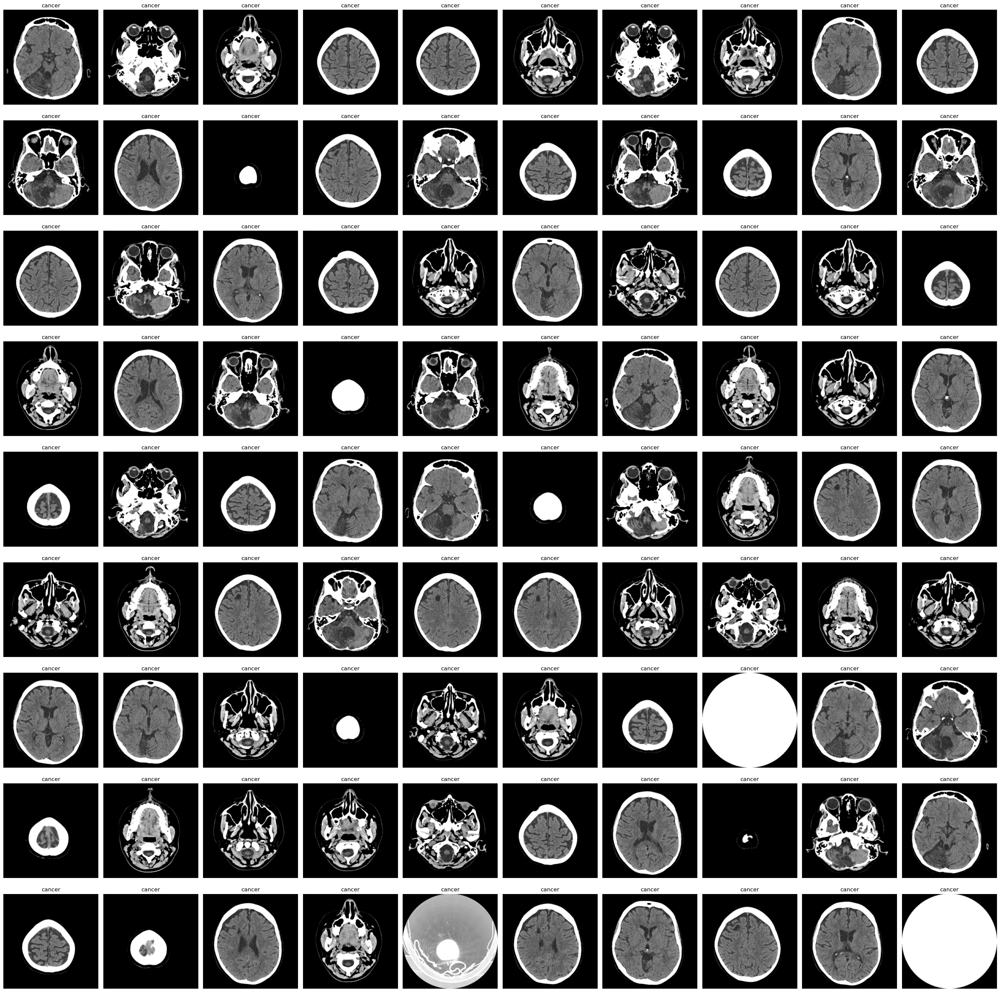

In [ ]:
image_class(shuffled_images, shuffled_labels, 'cancer')





A maximum of 90 images will be shown


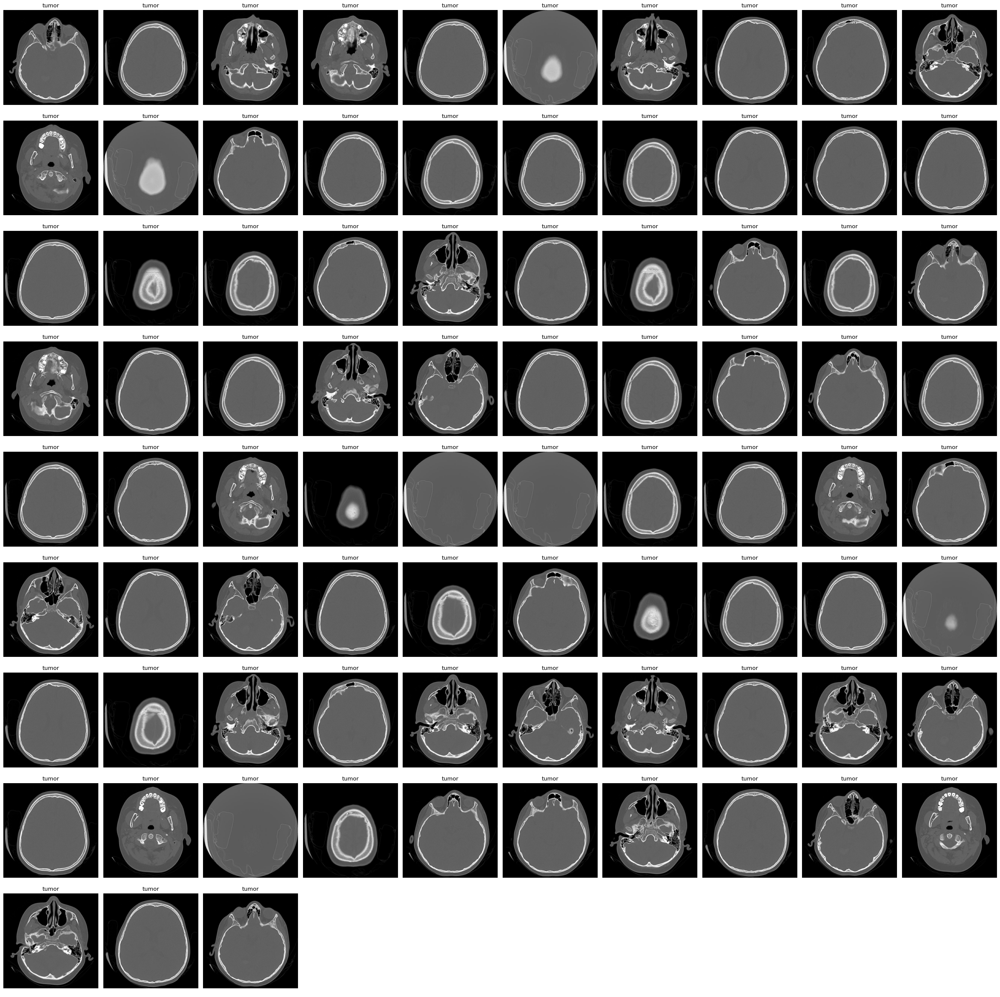

In [ ]:
image_class(shuffled_images, shuffled_labels, 'tumor')

A maximum of 90 images will be shown


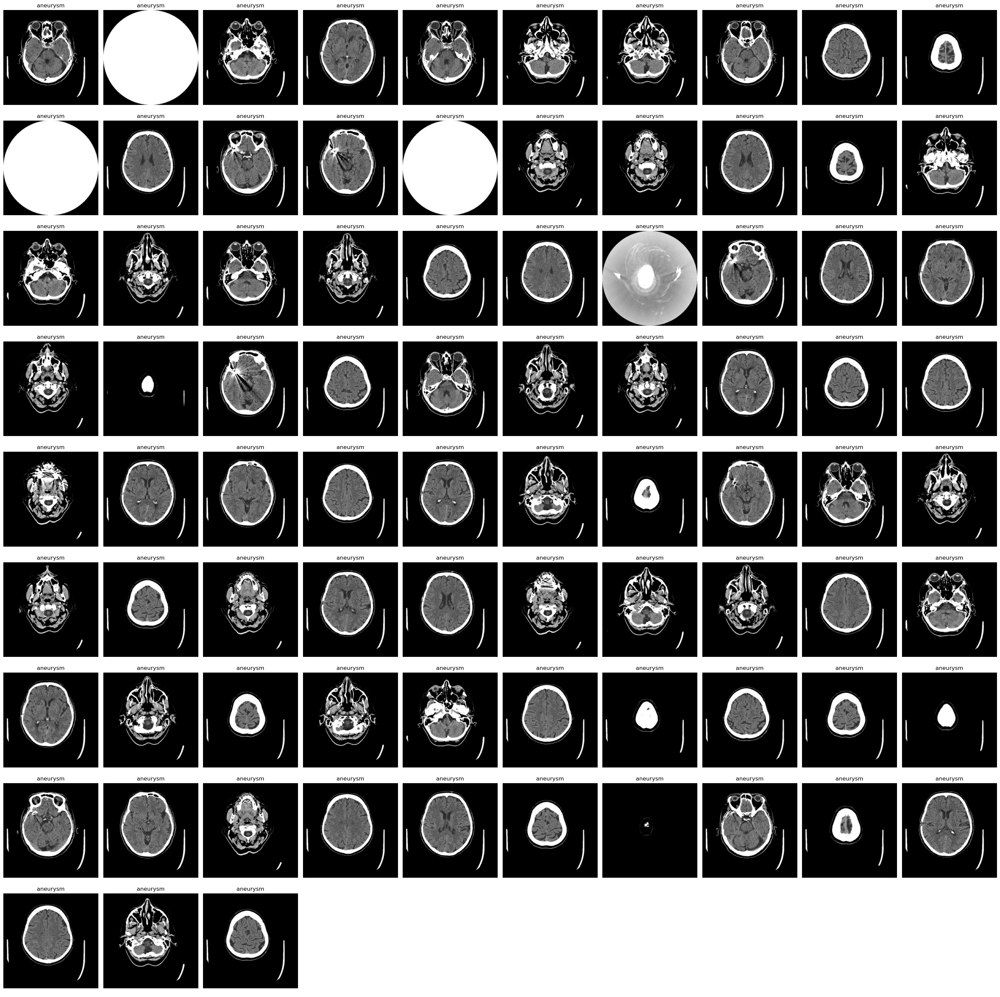

In [ ]:
image_class(shuffled_images, shuffled_labels, 'aneurysm')

From the images we can visually see that

# Models

In [ ]:
model1= cnn()

model1.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 222, 222, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2  (None, 111, 111, 32)      0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 109, 109, 64)      18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 54, 54, 64)        0         
 g2D)                                                            
                                                                 
 flatten (Flatten)           (None, 186624)            0         
                                                                 
 dropout (Dropout)           (None, 186624)            0

In [ ]:
#VGG16 base model
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3),
                   pooling='max')

model = Sequential([
    base_model,
    Flatten(),
    Dense(256, activation='relu', kernel_regularizer=l2(0.001)),
    Dropout(0.3),
    BatchNormalization(),
    Dense(128, activation='relu', kernel_regularizer=l2(0.001)),
    Dropout(0.3),
    Dense(3, activation='softmax')
])
model.compile(optimizer='adadelta', loss='categorical_crossentropy', metrics=['accuracy'])
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 512)               14714688  
                                                                 
 flatten_1 (Flatten)         (None, 512)               0         
                                                                 
 dense_2 (Dense)             (None, 256)               131328    
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 batch_normalization (Batch  (None, 256)               1024      
 Normalization)                                                  
                                                                 
 dense_3 (Dense)             (None, 128)               32896     
                                                      

# Test and train split

In [ ]:
# splitting out the data
X_train, X_test, y_train, y_test= train_test_split(shuffled_images, shuffled_labels, test_size=0.2, random_state=123)
# need to convert to categorical otherwise categorical crossentropy wont work
y_train= to_categorical(y_train, num_classes)
y_test= to_categorical(y_test, num_classes)

In [ ]:
print(f"X_train shape: {X_train.shape}")
print(f"X_test shape: {X_test.shape}")
print(f"y_train shape: {y_train.shape}")
print(f"y_test shape: {y_test.shape}")


X_train shape: (204, 224, 224, 3)
X_test shape: (52, 224, 224, 3)
y_train shape: (204, 3)
y_test shape: (52, 3)


In [ ]:
# will use early stopping to stop the model to make it less computationally expensive
early_stopping = EarlyStopping(monitor='val_loss', patience=5, verbose=1, restore_best_weights=True)

In [ ]:
# stratified k fold
skf= StratifiedKFold(n_splits=5, shuffle=True, random_state=123)

# creating list to keep all the performances
adagrad_histories= []

classification_reports= []

# Perform cross-validation
for fold_index, (train_index, test_index) in enumerate(skf.split(shuffled_images, shuffled_labels), 1):
    print("Fold:", fold_index)

    #splitting dataset, kfolds split via the indexes, need to ensure y is categorical
    X_train, X_test= shuffled_images[train_index], shuffled_images[test_index]
    y_train, y_test= shuffled_labels[train_index], shuffled_labels[test_index]
    y_train= to_categorical(y_train, num_classes=3)
    y_test= to_categorical(y_test, num_classes=3)


    # initiating model
    adagrad_model= cnn(drop_out=0.1, optimiser='adagrad')

    history= adagrad_model.fit(X_train, y_train, epochs=30, verbose=1, validation_data=(X_test, y_test),
                        callbacks=[early_stopping])

    #qppend history, need for plots
    adagrad_histories.append(history)

    #prediction
    y_pred= adagrad_model.predict(X_test)

    report= classification_report(np.argmax(y_test, axis=1), np.argmax(y_pred, axis=1))

    #appending classification to get averages
    classification_reports.append(report)


concatenated_report= '\n'.join(classification_reports)
print(concatenated_report)






Fold: 1
Epoch 1/30
7/7 [==============================] - 6s 812ms/step - loss: 0.9738 - accuracy: 0.5686 - val_loss: 0.7191 - val_accuracy: 0.8462
Epoch 2/30
7/7 [==============================] - 5s 751ms/step - loss: 0.6508 - accuracy: 0.8039 - val_loss: 0.4966 - val_accuracy: 0.9231
Epoch 3/30
7/7 [==============================] - 6s 812ms/step - loss: 0.5018 - accuracy: 0.8382 - val_loss: 0.3897 - val_accuracy: 0.9231
Epoch 4/30
7/7 [==============================] - 6s 823ms/step - loss: 0.4344 - accuracy: 0.8824 - val_loss: 0.3202 - val_accuracy: 0.9231
Epoch 5/30
7/7 [==============================] - 6s 783ms/step - loss: 0.3101 - accuracy: 0.9265 - val_loss: 0.2587 - val_accuracy: 0.9615
Epoch 6/30
7/7 [==============================] - 6s 825ms/step - loss: 0.3004 - accuracy: 0.9118 - val_loss: 0.2333 - val_accuracy: 0.9423
Epoch 7/30
7/7 [==============================] - 6s 802ms/step - loss: 0.2450 - accuracy: 0.9363 - val_loss: 0.1893 - val_accuracy: 0.9615
Epoch 8/30
7

Epoch 29/30
7/7 [==============================] - 5s 761ms/step - loss: 0.1021 - accuracy: 0.9805 - val_loss: 0.0280 - val_accuracy: 1.0000
Epoch 30/30
2/2 [==============================] - 0s 99ms/step
Fold: 3
Epoch 1/30
7/7 [==============================] - 6s 861ms/step - loss: 1.0249 - accuracy: 0.5463 - val_loss: 0.8710 - val_accuracy: 0.7059
Epoch 2/30
7/7 [==============================] - 6s 817ms/step - loss: 0.7979 - accuracy: 0.7951 - val_loss: 0.6931 - val_accuracy: 0.7647
Epoch 3/30
7/7 [==============================] - 6s 816ms/step - loss: 0.6187 - accuracy: 0.8098 - val_loss: 0.5596 - val_accuracy: 0.9020
Epoch 4/30
7/7 [==============================] - 5s 775ms/step - loss: 0.5063 - accuracy: 0.8634 - val_loss: 0.4559 - val_accuracy: 0.8824
Epoch 5/30
7/7 [==============================] - 6s 786ms/step - loss: 0.4230 - accuracy: 0.8732 - val_loss: 0.3847 - val_accuracy: 0.9020
Epoch 6/30
7/7 [==============================] - 5s 772ms/step - loss: 0.3590 - accura

7/7 [==============================] - 5s 781ms/step - loss: 0.1067 - accuracy: 0.9707 - val_loss: 0.1066 - val_accuracy: 0.9804
Epoch 26/30
7/7 [==============================] - 5s 770ms/step - loss: 0.0773 - accuracy: 0.9854 - val_loss: 0.1424 - val_accuracy: 0.9804
Epoch 27/30
7/7 [==============================] - 5s 772ms/step - loss: 0.0788 - accuracy: 0.9854 - val_loss: 0.2196 - val_accuracy: 0.9412
Epoch 28/30
7/7 [==============================] - 5s 775ms/step - loss: 0.0846 - accuracy: 0.9805 - val_loss: 0.1359 - val_accuracy: 0.9804
Epoch 29/30
7/7 [==============================] - 6s 796ms/step - loss: 0.0759 - accuracy: 0.9805 - val_loss: 0.1337 - val_accuracy: 0.9804
Epoch 30/30
7/7 [==============================] - 5s 763ms/step - loss: 0.0769 - accuracy: 0.9756 - val_loss: 0.2132 - val_accuracy: 0.9412
Epoch 30: early stopping
2/2 [==============================] - 0s 89ms/step
Fold: 5
Epoch 1/30
7/7 [==============================] - 6s 797ms/step - loss: 0.9220 - 

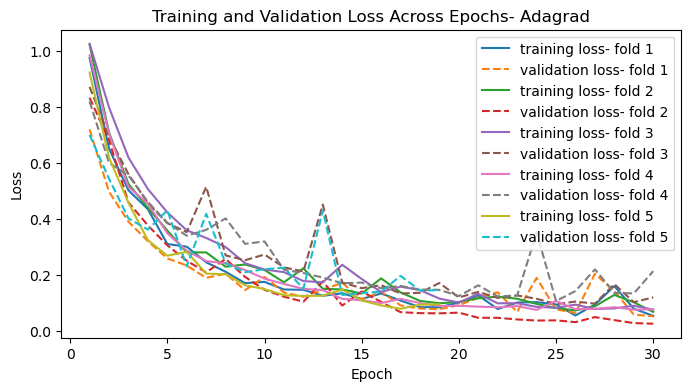

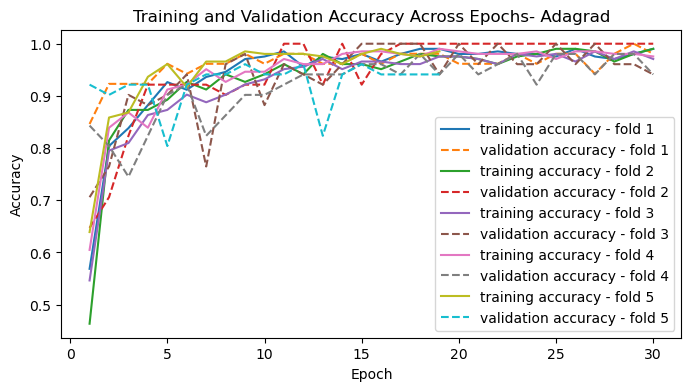

In [ ]:
# plotting averages and losses
plt.figure(figsize=(8, 4))
for fold_ind, history in enumerate(adagrad_histories, 1):
    num_epochs= len(history.history['loss'])
    epochs= np.arange(1, num_epochs+ 1)
    plt.plot(epochs, history.history['loss'], label='training loss- fold {}'.format(fold_ind), linestyle='-')
    plt.plot(epochs, history.history['val_loss'], label='validation loss- fold {}'.format(fold_ind), linestyle='--')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Loss Across Epochs- Adagrad')
plt.legend()
plt.show()

plt.figure(figsize=(8, 4))
for fold_ind, history in enumerate(adagrad_histories, 1):
    num_epochs= len(history.history['accuracy'])
    epochs= np.arange(1, num_epochs+ 1)
    plt.plot(epochs, history.history['accuracy'], label='training accuracy - fold {}'.format(fold_ind), linestyle='-')
    plt.plot(epochs, history.history['val_accuracy'],
             label='validation accuracy - fold {}'.format(fold_ind), linestyle='--')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Training and Validation Accuracy Across Epochs- Adagrad')
plt.legend()
plt.show()


In [ ]:
# stratified k fold
skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=123)

# creating list to keep all the performances
adadelta_histories= []

classification_reports= []

# Perform cross-validation
for fold_ind, (train_ind, test_ind) in enumerate(skf.split(shuffled_images, shuffled_labels), 1):
    print("Fold:", fold_ind)

    #splitting dataset, kfolds split via the indexes, need to ensure y is categorical
    X_train, X_test= shuffled_images[train_ind], shuffled_images[test_ind]
    y_train, y_test= shuffled_labels[train_ind], shuffled_labels[test_ind]
    y_train= to_categorical(y_train, num_classes=3)
    y_test= to_categorical(y_test, num_classes=3)


    # initiating model
    adadelta_model= cnn(drop_out=0.1, optimiser='adadelta')

    history= adadelta_model.fit(X_train, y_train, epochs=30, verbose=1, validation_data=(X_test, y_test),
                        callbacks=[early_stopping])

    #qppend history, need for plots
    adadelta_histories.append(history)

    #prediction
    y_pred= adadelta_model.predict(X_test)

    report= classification_report(np.argmax(y_test, axis=1), np.argmax(y_pred, axis=1))

    #appending classification to get averages
    classification_reports.append(report)


concatenated_report= '\n'.join(classification_reports)
print(concatenated_report)


Fold: 1
Epoch 1/30
7/7 [==============================] - 8s 1s/step - loss: 1.0795 - accuracy: 0.4706 - val_loss: 1.0511 - val_accuracy: 0.4038
Epoch 2/30
7/7 [==============================] - 7s 954ms/step - loss: 1.0372 - accuracy: 0.5637 - val_loss: 1.0106 - val_accuracy: 0.5769
Epoch 3/30
7/7 [==============================] - 7s 957ms/step - loss: 0.9972 - accuracy: 0.6569 - val_loss: 0.9697 - val_accuracy: 0.6154
Epoch 4/30
7/7 [==============================] - 6s 914ms/step - loss: 0.9572 - accuracy: 0.7304 - val_loss: 0.9281 - val_accuracy: 0.7885
Epoch 5/30
7/7 [==============================] - 7s 931ms/step - loss: 0.9144 - accuracy: 0.7353 - val_loss: 0.8879 - val_accuracy: 0.8269
Epoch 6/30
7/7 [==============================] - 7s 947ms/step - loss: 0.8760 - accuracy: 0.8235 - val_loss: 0.8516 - val_accuracy: 0.8077
Epoch 7/30
7/7 [==============================] - 6s 909ms/step - loss: 0.8388 - accuracy: 0.7990 - val_loss: 0.8150 - val_accuracy: 0.8462
Epoch 8/30
7/7 

Epoch 29/30
7/7 [==============================] - 7s 925ms/step - loss: 0.4074 - accuracy: 0.9122 - val_loss: 0.4054 - val_accuracy: 0.8627
Epoch 30/30
2/2 [==============================] - 0s 87ms/step
Fold: 3
Epoch 1/30
7/7 [==============================] - 8s 998ms/step - loss: 1.0770 - accuracy: 0.3366 - val_loss: 1.0439 - val_accuracy: 0.3333
Epoch 2/30
7/7 [==============================] - 7s 1s/step - loss: 1.0278 - accuracy: 0.4195 - val_loss: 0.9997 - val_accuracy: 0.3725
Epoch 3/30
7/7 [==============================] - 7s 974ms/step - loss: 0.9801 - accuracy: 0.5463 - val_loss: 0.9568 - val_accuracy: 0.6275
Epoch 4/30
7/7 [==============================] - 7s 996ms/step - loss: 0.9381 - accuracy: 0.7220 - val_loss: 0.9145 - val_accuracy: 0.8431
Epoch 5/30
7/7 [==============================] - 7s 956ms/step - loss: 0.8930 - accuracy: 0.8146 - val_loss: 0.8714 - val_accuracy: 0.8824
Epoch 6/30
7/7 [==============================] - 7s 1s/step - loss: 0.8526 - accuracy: 0.

Epoch 27/30
7/7 [==============================] - 7s 1s/step - loss: 0.3058 - accuracy: 0.9268 - val_loss: 0.3528 - val_accuracy: 0.8627
Epoch 28/30
7/7 [==============================] - 7s 1s/step - loss: 0.2917 - accuracy: 0.9268 - val_loss: 0.3475 - val_accuracy: 0.8627
Epoch 29/30
7/7 [==============================] - 7s 1s/step - loss: 0.2848 - accuracy: 0.9415 - val_loss: 0.3383 - val_accuracy: 0.8824
Epoch 30/30
2/2 [==============================] - 0s 113ms/step
Fold: 5
Epoch 1/30
7/7 [==============================] - 9s 1s/step - loss: 1.0603 - accuracy: 0.4634 - val_loss: 1.0271 - val_accuracy: 0.6078
Epoch 2/30
7/7 [==============================] - 7s 1s/step - loss: 1.0014 - accuracy: 0.6439 - val_loss: 0.9679 - val_accuracy: 0.6471
Epoch 3/30
7/7 [==============================] - 7s 940ms/step - loss: 0.9445 - accuracy: 0.7268 - val_loss: 0.9131 - val_accuracy: 0.7843
Epoch 4/30
7/7 [==============================] - 6s 904ms/step - loss: 0.8905 - accuracy: 0.7805 -

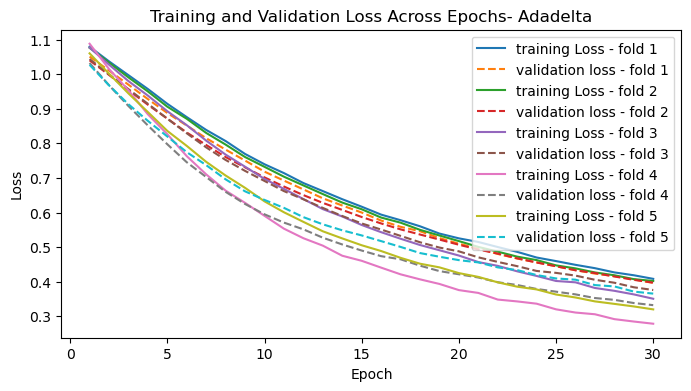

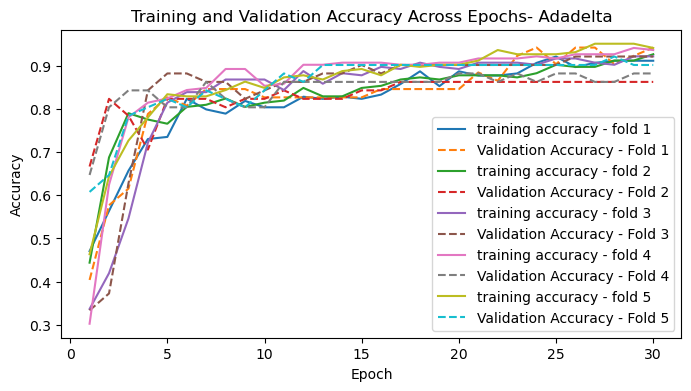

In [ ]:
## plotting averages and losses
plt.figure(figsize=(8, 4))
for fold_ind, history in enumerate(adadelta_histories, 1):
    num_epochs = len(history.history['loss'])
    epochs = np.arange(1, num_epochs + 1)
    plt.plot(epochs, history.history['loss'], label='training Loss - fold {}'.format(fold_ind), linestyle='-')
    plt.plot(epochs, history.history['val_loss'], label='validation loss - fold {}'.format(fold_ind), linestyle='--')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Loss Across Epochs- Adadelta')
plt.legend()
plt.show()

plt.figure(figsize=(8, 4))
for fold_ind, history in enumerate(adadelta_histories, 1):
    num_epochs = len(history.history['accuracy'])
    epochs = np.arange(1, num_epochs + 1)
    plt.plot(epochs, history.history['accuracy'], label='training accuracy - fold {}'.format(fold_ind), linestyle='-')
    plt.plot(epochs, history.history['val_accuracy'],
             label='Validation Accuracy - Fold {}'.format(fold_ind), linestyle='--')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Training and Validation Accuracy Across Epochs- Adadelta')
plt.legend()
plt.show()


## test based on Chen and Shen (2017)

In [ ]:
#testing mixed kernals based on research paper
model = Sequential()
model.add(Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)))
model.add(MaxPooling2D((2, 2)))
model.add(Conv2D(64, (5, 5), activation='relu'))
model.add(MaxPooling2D((2, 2)))
model.add(Flatten())
model.add(Dropout(0.))
model.add(Dense(128, activation='relu'))
model.add(Dense(num_classes, activation='softmax'))

model.compile(optimizer="adadelta", loss='categorical_crossentropy', metrics=['accuracy'])

history = model.fit(X_train, y_train, epochs=30, verbose=1, validation_data=(X_test, y_test),
                        callbacks=[early_stopping])

Epoch 1/30
7/7 [==============================] - 10s 1s/step - loss: 1.0906 - accuracy: 0.3659 - val_loss: 1.0616 - val_accuracy: 0.4510
Epoch 2/30
7/7 [==============================] - 9s 1s/step - loss: 1.0409 - accuracy: 0.5756 - val_loss: 1.0149 - val_accuracy: 0.7059
Epoch 3/30
7/7 [==============================] - 9s 1s/step - loss: 0.9953 - accuracy: 0.7317 - val_loss: 0.9715 - val_accuracy: 0.8039
Epoch 4/30
7/7 [==============================] - 11s 2s/step - loss: 0.9532 - accuracy: 0.7805 - val_loss: 0.9329 - val_accuracy: 0.7843
Epoch 5/30
7/7 [==============================] - 11s 2s/step - loss: 0.9147 - accuracy: 0.8098 - val_loss: 0.8949 - val_accuracy: 0.7843
Epoch 6/30
7/7 [==============================] - 12s 2s/step - loss: 0.8784 - accuracy: 0.7902 - val_loss: 0.8612 - val_accuracy: 0.7843
Epoch 7/30
7/7 [==============================] - 11s 2s/step - loss: 0.8438 - accuracy: 0.7854 - val_loss: 0.8307 - val_accuracy: 0.7843
Epoch 8/30
7/7 [====================

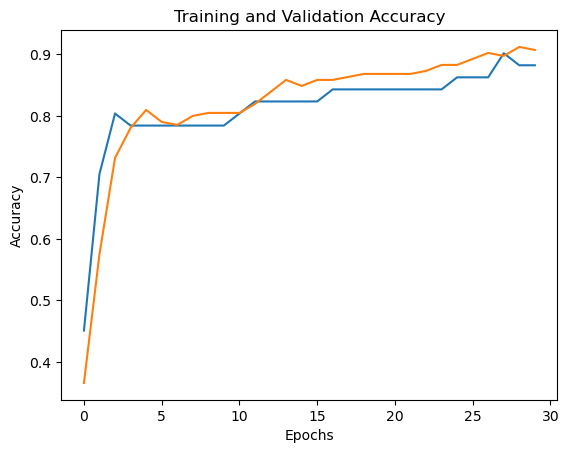

In [ ]:
mixed_kernal = history.history
plot_accuracy(mixed_kernal, num_epochs)

accurace and validation accuracy are quite close but the model takes slightly longer to run

## testing model with more layers

In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
model = Sequential()
model.add(Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)))
model.add(Conv2D(32, (3, 3), activation='relu'))
model.add(MaxPooling2D((2, 2)))
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D((2, 2)))
model.add(Conv2D(128, (3, 3), activation='relu'))
model.add(MaxPooling2D((2, 2)))
model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dropout(0.1))
model.add(Dense(num_classes, activation='softmax'))


model.compile(optimizer='adadelta', loss='categorical_crossentropy', metrics=['accuracy'])

num_epochs = 30
history = model.fit(X_train, y_train, validation_data=(X_test, y_test), epochs=num_epochs)

test_loss, test_accuracy = model.evaluate(X_test, y_test)
print(f'Test Loss: {test_loss}, Test Accuracy: {test_accuracy}')

Epoch 1/30
7/7 [==============================] - 17s 2s/step - loss: 1.1046 - accuracy: 0.3317 - val_loss: 1.0980 - val_accuracy: 0.2941
Epoch 2/30
7/7 [==============================] - 16s 2s/step - loss: 1.0870 - accuracy: 0.3561 - val_loss: 1.0796 - val_accuracy: 0.3922
Epoch 3/30
7/7 [==============================] - 19s 3s/step - loss: 1.0711 - accuracy: 0.4732 - val_loss: 1.0605 - val_accuracy: 0.5098
Epoch 4/30
7/7 [==============================] - 19s 3s/step - loss: 1.0532 - accuracy: 0.5707 - val_loss: 1.0432 - val_accuracy: 0.6275
Epoch 5/30
7/7 [==============================] - 18s 3s/step - loss: 1.0335 - accuracy: 0.6049 - val_loss: 1.0264 - val_accuracy: 0.6667
Epoch 6/30
7/7 [==============================] - 16s 2s/step - loss: 1.0162 - accuracy: 0.6488 - val_loss: 1.0087 - val_accuracy: 0.6863
Epoch 7/30
7/7 [==============================] - 16s 2s/step - loss: 1.0035 - accuracy: 0.6439 - val_loss: 0.9914 - val_accuracy: 0.7255
Epoch 8/30
7/7 [==================

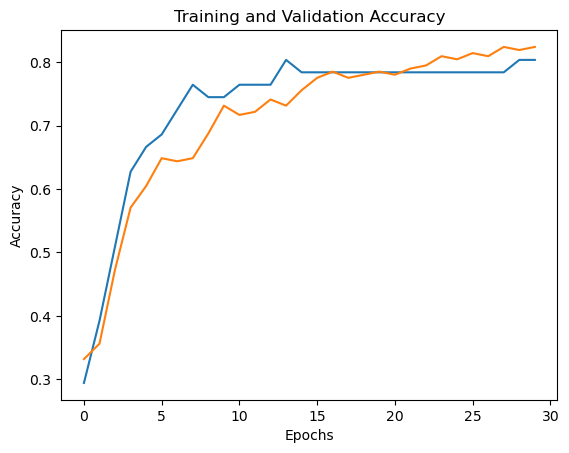

In [ ]:
more_layers_hist = history.history
epochs = 30
plot_accuracy(more_layers_hist,epochs)

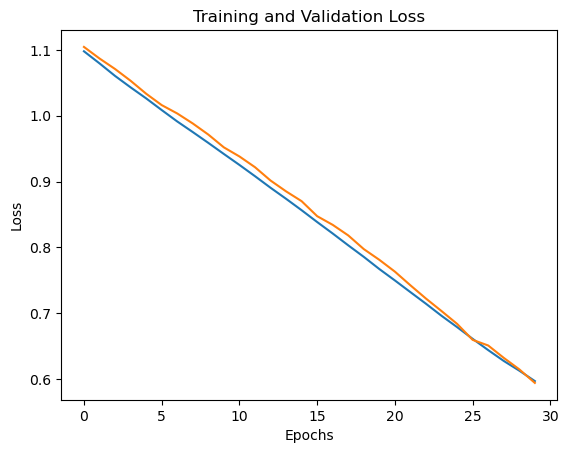

In [ ]:
epochs=30
plot_validation(more_layers_hist, epochs)

In [ ]:
report,_,_=class_report(X_test,y_test)

print(report)


2/2 [==============================] - 1s 212ms/step
              precision    recall  f1-score   support

           0       1.00      0.94      0.97        16
           1       0.70      0.89      0.78        18
           2       0.77      0.59      0.67        17

    accuracy                           0.80        51
   macro avg       0.82      0.80      0.80        51
weighted avg       0.82      0.80      0.80        51



https://www.youtube.com/watch?v=eCECXr-HxVs


https://dicom.innolitics.com/ciods/cr-image/general-image/00200020

# Data augmentation

In [ ]:
early_stopping = EarlyStopping(monitor='val_loss', patience=5, verbose=1, restore_best_weights=True)

In [ ]:
from keras.preprocessing.image import ImageDataGenerator
import numpy as np

X_train, X_test, y_train, y_test= train_test_split(shuffled_images, shuffled_labels, test_size=0.2, random_state=42)
# need to convert to categorical otherwise categorical crossentropy wont work
y_train= to_categorical(y_train, num_classes)
y_test= to_categorical(y_test, num_classes)

#rotating images
datagen = ImageDataGenerator(rotation_range=5,
                             width_shift_range=0.1,
                             height_shift_range=0.1,
                            zca_epsilon=False)


#adding augmented into training set
augmented_images, augmented_labels = datagen.flow(X_train, y_train, batch_size=len(X_train), shuffle=False).next()
combined_images = np.concatenate([X_train, augmented_images])
combined_labels = np.concatenate([y_train, augmented_labels])
#shuffle again
shuffle_indices = np.random.permutation(len(combined_images))
combined_images = combined_images[shuffle_indices]
combined_labels = combined_labels[shuffle_indices]



In [ ]:
combined_labels.shape

(408, 3)

In [ ]:
X_test.shape

(52, 224, 224, 3)

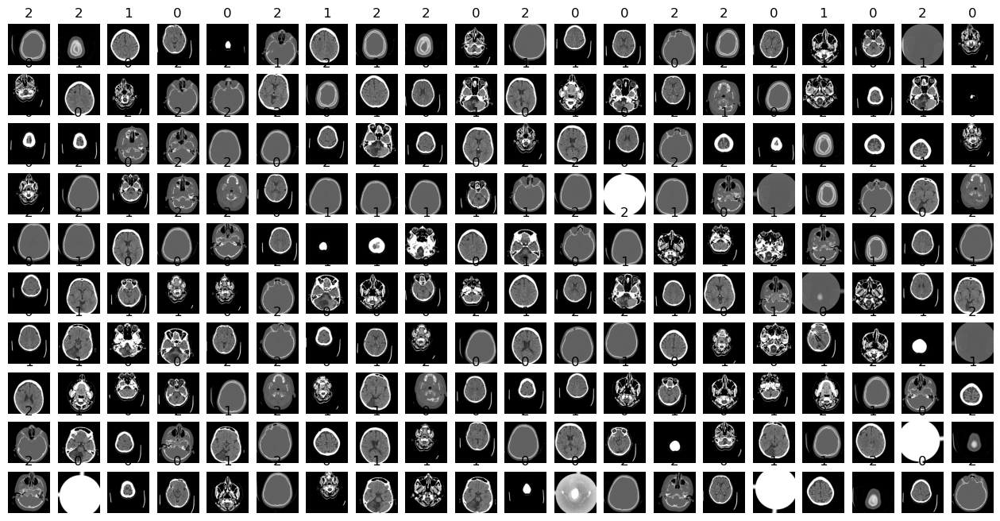

In [ ]:
#showing augmentation
plt.figure(figsize=(16, 8))
for i in range(200):
    plt.subplot(10, 20, i + 1)
    plt.imshow(augmented_images[i])
    plt.title(np.argmax(augmented_labels[i]))
    plt.axis('off')
plt.show()

In [ ]:
combined_labels.shape

(408, 3)

# Ada delta

In [ ]:
adad_aug_model = cnn(drop_out=0.2, optimiser='adadelta')
num_epochs=30

history = adad_aug_model.fit(combined_images, combined_labels, epochs=num_epochs,  validation_data=(X_test, y_test),
                   callbacks=[early_stopping ])

test_loss, test_accuracy = adad_aug_model.evaluate(X_test, y_test)
print(f'test loss: {test_loss}, test accuracy: {test_accuracy}')

Epoch 1/30
13/13 [==============================] - 14s 993ms/step - loss: 1.0905 - accuracy: 0.3725 - val_loss: 1.0649 - val_accuracy: 0.5000
Epoch 2/30
13/13 [==============================] - 12s 960ms/step - loss: 1.0358 - accuracy: 0.5784 - val_loss: 0.9980 - val_accuracy: 0.5962
Epoch 3/30
13/13 [==============================] - 12s 940ms/step - loss: 0.9897 - accuracy: 0.6348 - val_loss: 0.9352 - val_accuracy: 0.7115
Epoch 4/30
13/13 [==============================] - 13s 977ms/step - loss: 0.9426 - accuracy: 0.7108 - val_loss: 0.8786 - val_accuracy: 0.7692
Epoch 5/30
13/13 [==============================] - 12s 933ms/step - loss: 0.8949 - accuracy: 0.7574 - val_loss: 0.8256 - val_accuracy: 0.7885
Epoch 6/30
13/13 [==============================] - 12s 940ms/step - loss: 0.8556 - accuracy: 0.7451 - val_loss: 0.7855 - val_accuracy: 0.8269
Epoch 7/30
13/13 [==============================] - 12s 935ms/step - loss: 0.8192 - accuracy: 0.7525 - val_loss: 0.7466 - val_accuracy: 0.8654

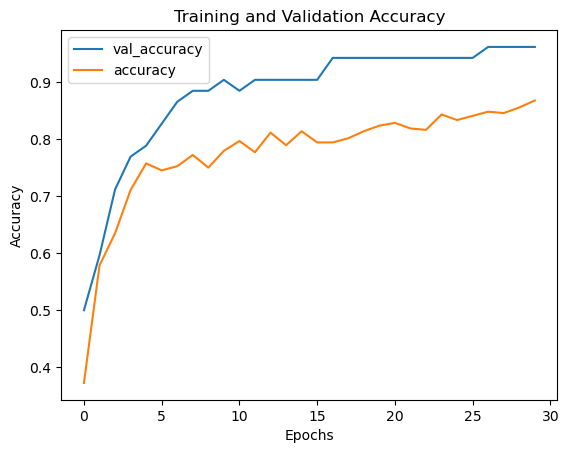

In [ ]:
adad_aug_hist = history.history
epochs = 30
plot_accuracy(adad_aug_hist,epochs)


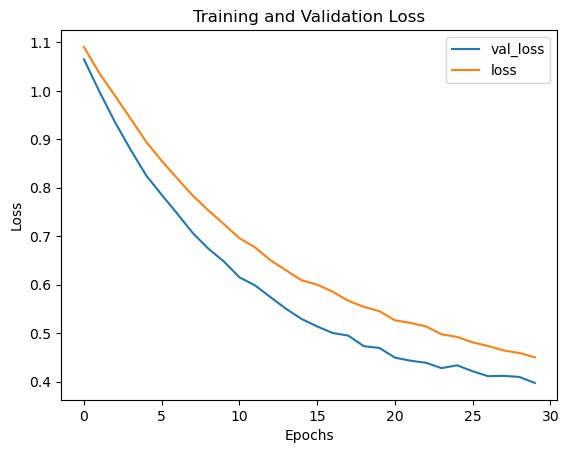

In [ ]:
plot_validation(adad_aug_hist,epochs)

In [ ]:
adad_report,y_pred_ada,y_true_ada=class_report(adad_aug_model,X_test,y_test)
print(adad_report)

2/2 [==============================] - 0s 94ms/step
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        16
           1       1.00      0.91      0.95        23
           2       0.87      1.00      0.93        13

    accuracy                           0.96        52
   macro avg       0.96      0.97      0.96        52
weighted avg       0.97      0.96      0.96        52



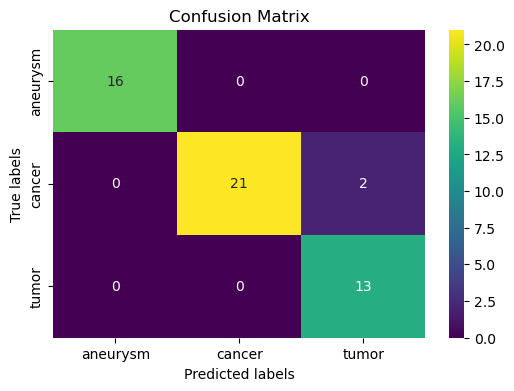

In [ ]:
confusion_m(y_true_ada,y_pred_ada)

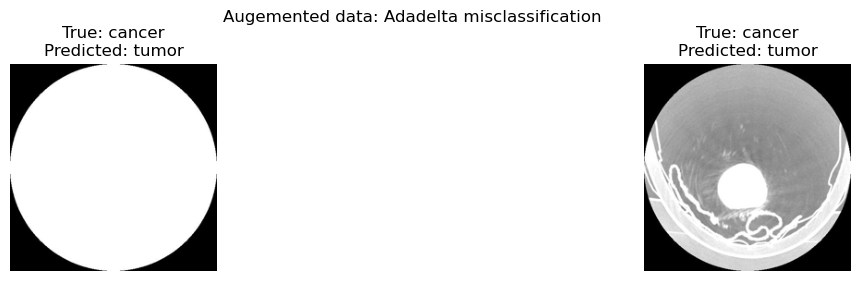

In [ ]:
fig, axes = plt.subplots(1,2, figsize=(15, 3))

wrong_preds = np.where(y_pred_ada != y_true_ada)[0]
wrong_preds_subset = wrong_preds[:6]

for i, idx in enumerate(wrong_preds_subset):
    axes[i].imshow(X_test[idx])
    axes[i].set_title(f'True: {class_names[y_true_ada[idx]]}\nPredicted: {class_names[y_pred_ada[idx]]}')
    axes[i].axis('off')

plt.subplots_adjust(top=0.8, hspace=0.5)
plt.suptitle("Augemented data: Adadelta misclassification")
plt.show()



# Adagrad

In [ ]:

grad_aug_model = cnn(drop_out=0.2, optimiser='adagrad')
num_epochs=30

history = grad_aug_model.fit(combined_images, combined_labels, epochs=num_epochs,  validation_data=(X_test, y_test),
                   callbacks=[early_stopping ])

test_loss, test_accuracy = grad_aug_model.evaluate(X_test, y_test)
print(f'test loss: {test_loss}, test accuracy: {test_accuracy}')

Epoch 1/30
13/13 [==============================] - 12s 847ms/step - loss: 0.8834 - accuracy: 0.6691 - val_loss: 0.5381 - val_accuracy: 0.8077
Epoch 2/30
13/13 [==============================] - 11s 833ms/step - loss: 0.6050 - accuracy: 0.7843 - val_loss: 0.5230 - val_accuracy: 0.9423
Epoch 3/30
13/13 [==============================] - 11s 819ms/step - loss: 0.5516 - accuracy: 0.8039 - val_loss: 0.4629 - val_accuracy: 0.9038
Epoch 4/30
13/13 [==============================] - 10s 801ms/step - loss: 0.4410 - accuracy: 0.8456 - val_loss: 0.9435 - val_accuracy: 0.6923
Epoch 5/30
13/13 [==============================] - 10s 796ms/step - loss: 0.4221 - accuracy: 0.8505 - val_loss: 0.7631 - val_accuracy: 0.7885
Epoch 6/30
13/13 [==============================] - 10s 792ms/step - loss: 0.3863 - accuracy: 0.8627 - val_loss: 0.4385 - val_accuracy: 0.9231
Epoch 7/30
13/13 [==============================] - 10s 791ms/step - loss: 0.3332 - accuracy: 0.8873 - val_loss: 0.3363 - val_accuracy: 0.9231

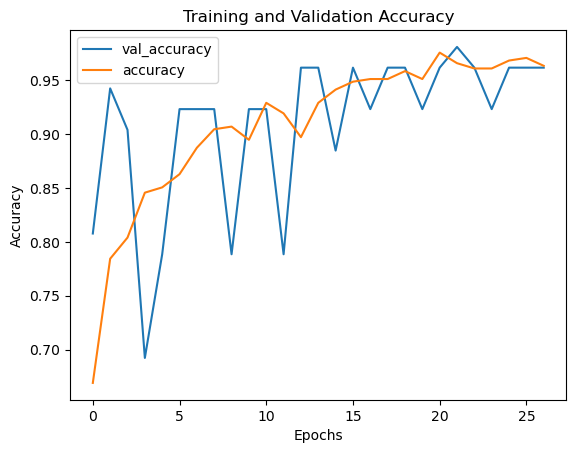

In [ ]:
adag_hist= history.history
epochs =27
plot_accuracy(adag_hist,epochs)


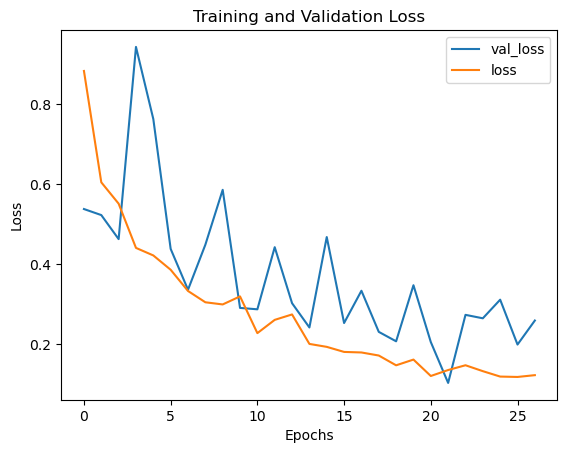

In [ ]:
plot_validation(adag_hist,epochs)

In [ ]:
adag_report,y_pred_adag,y_true_adag=class_report(grad_aug_model,X_test,y_test)
print(adag_report)

2/2 [==============================] - 0s 102ms/step
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        16
           1       1.00      0.96      0.98        23
           2       0.93      1.00      0.96        13

    accuracy                           0.98        52
   macro avg       0.98      0.99      0.98        52
weighted avg       0.98      0.98      0.98        52



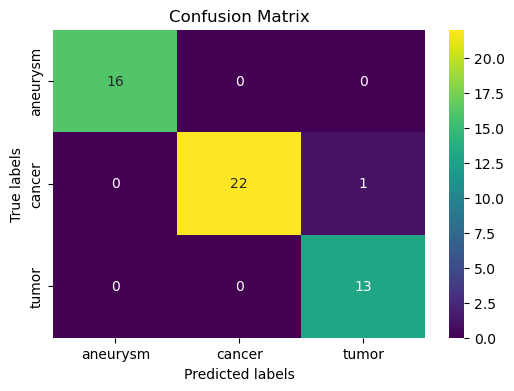

In [ ]:
confusion_m(y_true_adag,y_pred_adag)

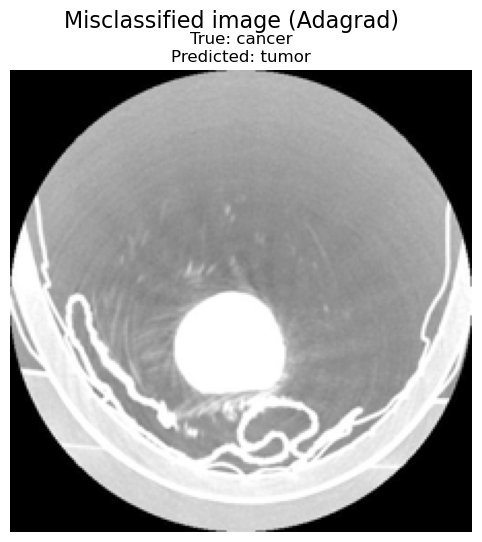

In [ ]:
plt.figure(figsize=(8, 6))

wrong_preds = np.where(y_pred_adag != y_true_adag)[0]
wrong_preds_subset = wrong_preds[:1]

for idx in wrong_preds_subset:
    plt.imshow(X_test[idx])
    plt.title(f'True: {class_names[y_true_adag[idx]]}\nPredicted: {class_names[y_pred_adag[idx]]}')
    plt.axis('off')


plt.suptitle("Misclassified image (Adagrad)", fontsize=16)
plt.show()


In [ ]:
start_time = time.time()
#base model vgg16, include false supposed to make model faster
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3),
                   pooling='max')

vgg16model = Sequential([
    base_model,
    Flatten(),
    Dense(256, activation='relu', kernel_regularizer=l2(0.001)),
    Dropout(0.3),
    BatchNormalization(),
    Dense(128, activation='relu', kernel_regularizer=l2(0.001)),
    Dropout(0.3),
    Dense(3, activation='softmax')
])

#using adadelta as it seemed a bit more stable
vgg16model.compile(optimizer='adadelta', loss='categorical_crossentropy', metrics=['accuracy'])


history= vgg16model.fit(combined_images, combined_labels, epochs=30, verbose=1, validation_data=(X_test, y_test),
                    callbacks=early_stopping)

test_loss, test_accuracy = vgg16model.evaluate(X_test, y_test)
print(f'test loss: {test_loss}, test accuracy: {test_accuracy}')

end_time= time.time()
elapsed_time= end_time-start_time
#printing time as it is a very slow model
print("Elapsed time:", elapsed_time, "seconds")

Epoch 1/30
13/13 [==============================] - 160s 12s/step - loss: 1.7946 - accuracy: 0.4314 - val_loss: 2.0191 - val_accuracy: 0.4231
Epoch 2/30
13/13 [==============================] - 155s 12s/step - loss: 1.6474 - accuracy: 0.4877 - val_loss: 1.8844 - val_accuracy: 0.4423
Epoch 3/30
13/13 [==============================] - 155s 12s/step - loss: 1.5703 - accuracy: 0.5441 - val_loss: 1.7891 - val_accuracy: 0.4615
Epoch 4/30
13/13 [==============================] - 160s 12s/step - loss: 1.5274 - accuracy: 0.5074 - val_loss: 1.7030 - val_accuracy: 0.4808
Epoch 5/30
13/13 [==============================] - 159s 12s/step - loss: 1.3739 - accuracy: 0.6569 - val_loss: 1.6325 - val_accuracy: 0.5385
Epoch 6/30
13/13 [==============================] - 158s 12s/step - loss: 1.4175 - accuracy: 0.6127 - val_loss: 1.5729 - val_accuracy: 0.5962
Epoch 7/30
13/13 [==============================] - 168s 13s/step - loss: 1.3362 - accuracy: 0.6471 - val_loss: 1.5154 - val_accuracy: 0.6154
Epoch 

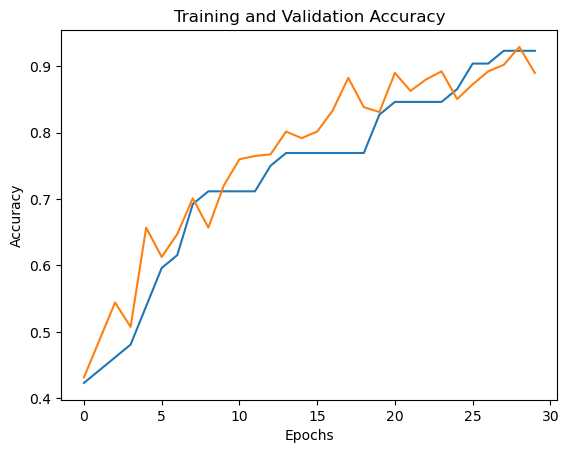

In [ ]:
num_epochs=30
vgg16_hist = history.history
epochs = list(range(num_epochs))
plot_accuracy(vgg16_hist, num_epochs)


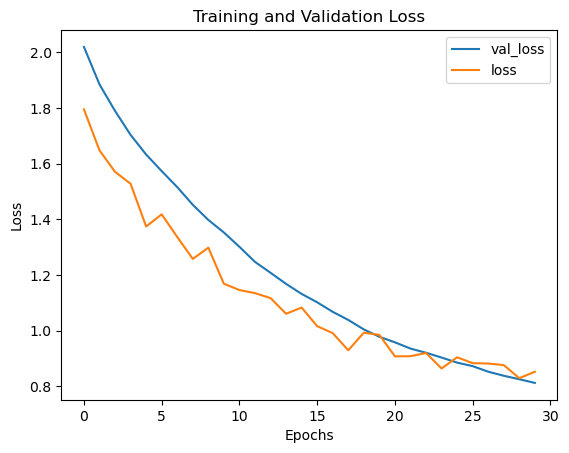

In [ ]:
plot_validation(vgg16_hist, num_epochs)


In [ ]:
report,y_pred_vgg16,y_true_vgg16=class_report(vgg16model,X_test,y_test)
print(report)

2/2 [==============================] - 4s 2s/step
              precision    recall  f1-score   support

           0       0.88      0.94      0.91        16
           1       0.95      0.87      0.91        23
           2       0.93      1.00      0.96        13

    accuracy                           0.92        52
   macro avg       0.92      0.94      0.93        52
weighted avg       0.92      0.92      0.92        52



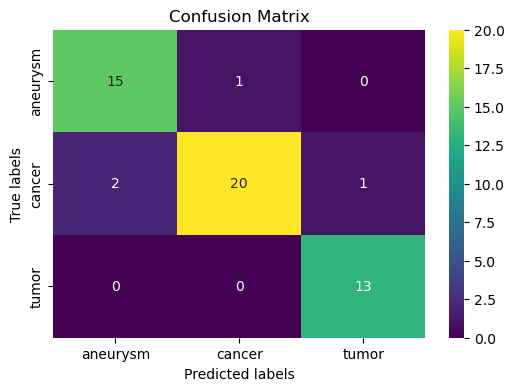

In [ ]:
confusion_m(y_true_vgg16,y_pred_vgg16)

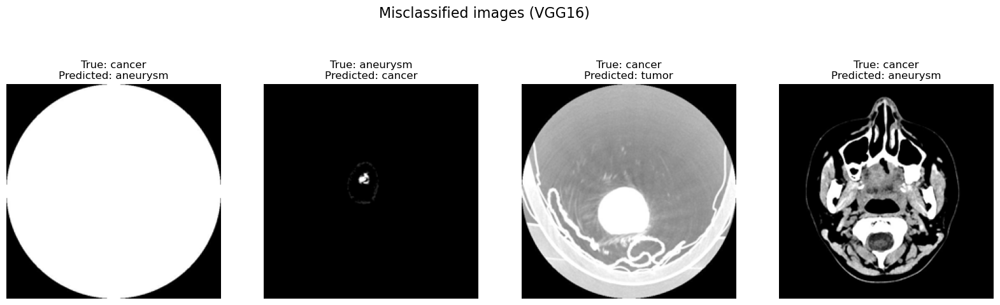

In [ ]:
fig, axes = plt.subplots(1, 4, figsize=(20, 6))


wrong_preds = np.where(y_pred_vgg16 != y_true_vgg16)[0]
wrong_preds_subset = wrong_preds[:4]


for i, idx in enumerate(wrong_preds_subset):
    axes[i].imshow(X_test[idx])
    axes[i].set_title(f'True: {class_names[y_true_vgg16[idx]]}\nPredicted: {class_names[y_pred_vgg16[idx]]}')
    axes[i].axis('off')

#plt.tight_layout()
plt.suptitle("Misclassified images (VGG16)", fontsize=16)
plt.show()



Compare to JPGs

references: https://towardsdatascience.com/understanding-dicom-bce665e62b72

https://www.youtube.com/watch?v=llq9-oJXepQ